# Import Libraries:

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from plotly.subplots import make_subplots
import pycountry 
import reverse_geocoder as rg 
import missingno


# Load Dataset:



In [2]:
df=pd.read_csv(r'covid_19_resourse_complete.csv')

In [3]:
print(f'Covid_19 Dataset includes about {df.shape[0] } rows')
print(f'Covid_19 Dataset includes about {df.shape[1] } columns')

Covid_19 Dataset includes about 49068 rows
Covid_19 Dataset includes about 10 columns


In [4]:
print(f'Columns Names :\n\t {df.columns.to_list()}')

Columns Names :
	 ['Province/State', 'Country/Region', 'Lat', 'Long', 'Date', 'Confirmed', 'Deaths', 'Recovered', 'Active', 'WHO Region']


### - Description about dataset:
1. Province/State
Description: Represents the subdivision of a country (e.g., states, provinces, regions). Not all countries have such subdivisions in the data, so this column might be empty or NaN for countries without provinces or states.
Example Values:
"New York" for the USA
"Hubei" for China
NaN for countries without subdivisions (e.g., Japan).
-------------------------------------------------------------------------
2. Country/Region
Description: Represents the name of the country or region where the data was recorded. It is used as a primary grouping column to aggregate cases and other statistics.
Example Values:
"United States"
"China"
"Italy"
-------------------------------------------------------------------------
3. Lat (Latitude)
Description: Represents the geographical latitude (in decimal degrees) of the location associated with the Province/State or Country/Region.
Use: Useful for geospatial visualizations, such as plotting on a map.
Example Values:
40.7128 (New York)
31.2304 (Shanghai)
-------------------------------------------------------------------------
4. Long (Longitude)
Description: Represents the geographical longitude (in decimal degrees) of the location associated with the Province/State or Country/Region.
Use: Similar to Lat, it is used for mapping purposes.
Example Values:
-74.0060 (New York)
121.4737 (Shanghai)
-------------------------------------------------------------------------
5. Date
Description: Represents the date of the recorded data. This feature is critical for time-series analysis, as it allows tracking the progression of the disease over time.
Format: Typically in YYYY-MM-DD format, but it might vary.
Example Values:
"2023-01-01"
"2023-01-02"
-------------------------------------------------------------------------
6. Confirmed
Description: Represents the cumulative number of confirmed cases reported up to the corresponding date. This includes both active and resolved cases.
Example Values:
500 (500 confirmed cases by the given date)
-------------------------------------------------------------------------
7. Deaths
Description: Represents the cumulative number of deaths reported due to the disease up to the corresponding date.
Example Values:
20 (20 deaths recorded by the given date)
-------------------------------------------------------------------------
8. Recovered
Description: Represents the cumulative number of recovered cases reported up to the corresponding date. Recovery definitions may vary by reporting authority.
Example Values:
450 (450 recoveries by the given date)
-------------------------------------------------------------------------
9. Active
Description: Represents the number of currently active cases (still infected)
Active Cases=Confirmed Cases−(Deaths+Recovered)
Example Values:
30 (30 active cases remain)
-------------------------------------------------------------------------
10. WHO Region
Description: Represents the World Health Organization (WHO) region in which the Country/Region is located. WHO categorizes countries into regions for better tracking and management.
Example Values:
"AMRO" (Americas)
"EURO" (Europe)
"AFRO" (Africa)
-------------------------------------------------------------------------

In [5]:
df.head()

,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths,Recovered,Active,WHO Region
0,NaN,Afghanistan,33.93911,67.709953,2020-01-22,0,0,0,0,Eastern Mediterranean
1,NaN,Albania,41.15330,20.168300,2020-01-22,0,0,0,0,Europe
2,NaN,Algeria,28.03390,1.659600,2020-01-22,0,0,0,0,Africa
3,NaN,Andorra,42.50630,1.521800,2020-01-22,0,0,0,0,Europe
4,NaN,Angola,-11.20270,17.873900,2020-01-22,0,0,0,0,Africa


In [6]:
df.tail()

,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths,Recovered,Active,WHO Region
49063,NaN,Sao Tome and Principe,0.186400,6.613100,2020-07-27,865,14,734,117,Africa
49064,NaN,Yemen,15.552727,48.516388,2020-07-27,1691,483,833,375,Eastern Mediterranean
49065,NaN,Comoros,-11.645500,43.333300,2020-07-27,354,7,328,19,Africa
49066,NaN,Tajikistan,38.861000,71.276100,2020-07-27,7235,60,6028,1147,Europe
49067,NaN,Lesotho,-29.610000,28.233600,2020-07-27,505,12,128,365,Africa


# Data Cleaning:
#### 1- Duplicated values
#### 2- Missing values
#### 3- Text Handeld
#### 4- outliers


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49068 entries, 0 to 49067
Data columns (total 10 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Province/State  14664 non-null  object 
 1   Country/Region  49068 non-null  object 
 2   Lat             49068 non-null  float64
 3   Long            49068 non-null  float64
 4   Date            49068 non-null  object 
 5   Confirmed       49068 non-null  int64  
 6   Deaths          49068 non-null  int64  
 7   Recovered       49068 non-null  int64  
 8   Active          49068 non-null  int64  
 9   WHO Region      49068 non-null  object 
dtypes: float64(2), int64(4), object(4)
memory usage: 3.7+ MB


In [8]:
# 1- check Duplicated:
print(f'Total Numbers of Duplicated values = {df.duplicated().sum()}')

Total Numbers of Duplicated values = 0


<Axes: >

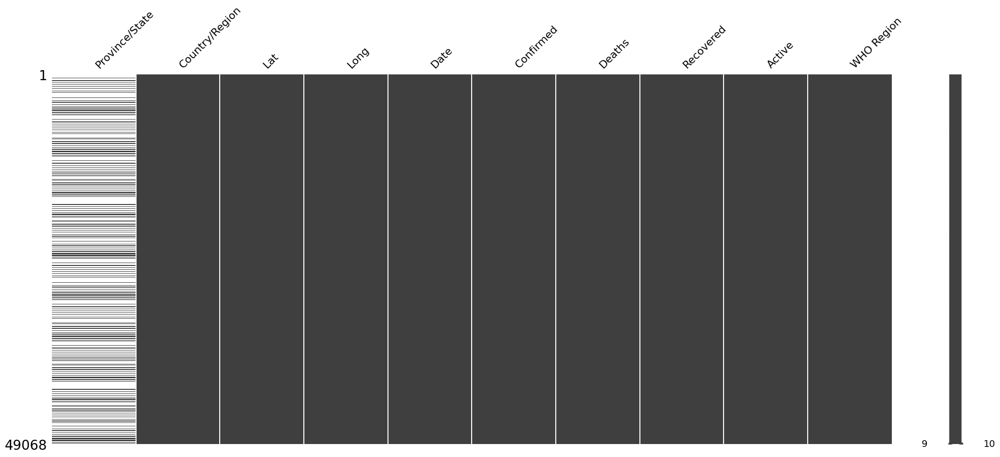

In [9]:
# 2- chech missing value:
missingno.matrix(df)

In [10]:
print('Missing values in each column :')
print(df.isnull().sum())
print(f'-----------------\nTotal:{df.isnull().sum().sum()}')

Missing values in each column :
Province/State    34404
Country/Region        0
Lat                   0
Long                  0
Date                  0
Confirmed             0
Deaths                0
Recovered             0
Active                0
WHO Region            0
dtype: int64
-----------------
Total:34404


In [11]:
print(f'Exist one Column "Province/State" include High ritio of missing value ={np.round(df['Province/State'].isna().sum()/df.shape[0],2)*100} % must be droped')
df.drop('Province/State',axis=1,inplace=True)

Exist one Column "Province/State" include High ritio of missing value =70.0 % must be droped


<Axes: >

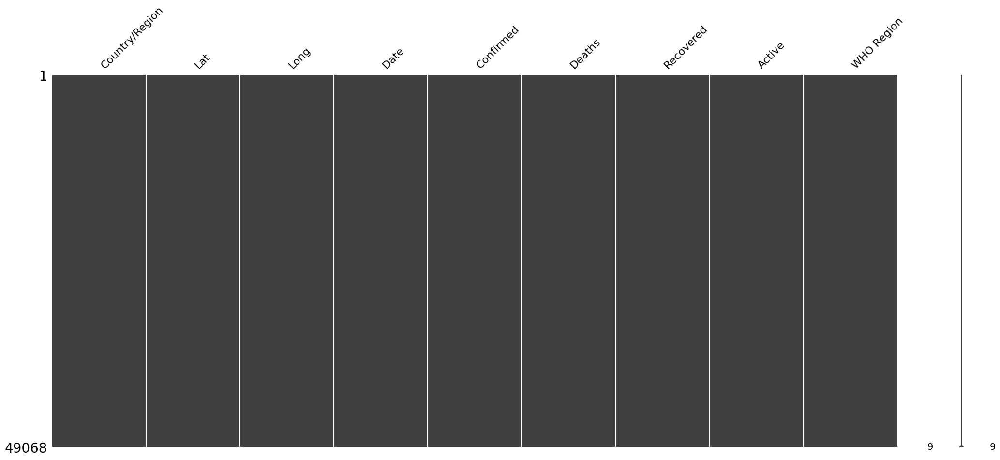

In [12]:
missingno.matrix(df)

In [13]:
print('Missing values in each column :')
print(df.isnull().sum())
print(f'-----------------\nTotal:{df.isnull().sum().sum()}')

Missing values in each column :
Country/Region    0
Lat               0
Long              0
Date              0
Confirmed         0
Deaths            0
Recovered         0
Active            0
WHO Region        0
dtype: int64
-----------------
Total:0


In [14]:
# 3- Text Handeled:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49068 entries, 0 to 49067
Data columns (total 9 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Country/Region  49068 non-null  object 
 1   Lat             49068 non-null  float64
 2   Long            49068 non-null  float64
 3   Date            49068 non-null  object 
 4   Confirmed       49068 non-null  int64  
 5   Deaths          49068 non-null  int64  
 6   Recovered       49068 non-null  int64  
 7   Active          49068 non-null  int64  
 8   WHO Region      49068 non-null  object 
dtypes: float64(2), int64(4), object(3)
memory usage: 3.4+ MB


In [15]:
#update name of columns
new_col=[]
for col in df.columns:
    col=col.replace('/',' ')
    col=col.title()
    col=col.replace(' ','')
    new_col.append(col)
df.columns=new_col
df.columns

Index(['CountryRegion', 'Lat', 'Long', 'Date', 'Confirmed', 'Deaths',
       'Recovered', 'Active', 'WhoRegion'],
      dtype='object')

In [16]:
# 1- Date: 
df.Date=pd.to_datetime(df.Date)



In [17]:
# 2- object features:
obj_cols=df.select_dtypes(include='object').columns.to_list()
for col in obj_cols:
    df[col]=df[col].str.title()
    df[col]=df[col].str.replace(' ','')
    df[col]=df[col].str.replace('-','')
    df[col]=df[col].str.strip(' ')
    

In [18]:
# 4- Outliers:
num_cols=df.select_dtypes(include=['int64','float64']).columns.to_list()[2:]
num_cols


['Confirmed', 'Deaths', 'Recovered', 'Active']

In [19]:
df[num_cols].describe()

,Confirmed,Deaths,Recovered,Active
count,4.906800e+04,49068.000000,4.906800e+04,4.906800e+04
mean,1.688490e+04,884.179160,7.915713e+03,8.085012e+03
std,1.273002e+05,6313.584411,5.480092e+04,7.625890e+04
min,0.000000e+00,0.000000,0.000000e+00,-1.400000e+01
25%,4.000000e+00,0.000000,0.000000e+00,0.000000e+00
50%,1.680000e+02,2.000000,2.900000e+01,2.600000e+01
75%,1.518250e+03,30.000000,6.660000e+02,6.060000e+02
max,4.290259e+06,148011.000000,1.846641e+06,2.816444e+06


In [20]:
# distribution:
for col in num_cols:
    px.histogram(
        df,
        x=col,
        nbins=30,
        title=col+' distribution',
        template='plotly_dark',
        width=850,
        height=350,

       
        
    ).show()

In [21]:
#skewness:
df[num_cols].skew()

Confirmed    18.567593
Deaths       13.740139
Recovered    16.380959
Active       22.306956
dtype: float64

In [22]:
# boxplot:
for col in num_cols:
    px.box(
        df,
        y=col,
       
        title=col+' box',
        template='plotly_dark',
        width=850,
        height=350, 
        
    ).show()

In [23]:
# calculate quartiles:
q1=df[num_cols].quantile(.25)
q3=df[num_cols].quantile(.75)
iqr=q3-q1
upper_fence=1.5*iqr+q3
lower_fence=q1-1.5*iqr


In [24]:
# update outliers:
for col in num_cols:
    df[col]=df[col].mask(df[col]>upper_fence[col],upper_fence[col])
    df[col]=df[col].mask(df[col]<lower_fence[col],lower_fence[col])


In [25]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49068 entries, 0 to 49067
Data columns (total 9 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   CountryRegion  49068 non-null  object        
 1   Lat            49068 non-null  float64       
 2   Long           49068 non-null  float64       
 3   Date           49068 non-null  datetime64[ns]
 4   Confirmed      49068 non-null  float64       
 5   Deaths         49068 non-null  int64         
 6   Recovered      49068 non-null  int64         
 7   Active         49068 non-null  int64         
 8   WhoRegion      49068 non-null  object        
dtypes: datetime64[ns](1), float64(3), int64(3), object(2)
memory usage: 3.4+ MB


In [26]:
df.Confirmed=df.Confirmed.astype('int64')    # casting float-> int 

In [27]:
df[num_cols].describe()

,Confirmed,Deaths,Recovered,Active
count,49068.000000,49068.000000,49068.000000,49068.000000
mean,1020.401035,19.649976,422.912693,393.950477
std,1449.431728,29.322769,632.061085,591.564311
min,0.000000,0.000000,0.000000,-14.000000
25%,4.000000,0.000000,0.000000,0.000000
50%,168.000000,2.000000,29.000000,26.000000
75%,1518.250000,30.000000,666.000000,606.000000
max,3789.000000,75.000000,1665.000000,1515.000000


In [28]:
# distribution:
for col in num_cols:
    px.histogram(
        df,
        x=col,
        nbins=30,
        title=col+' distribution',
        template='plotly_dark',
        width=850,
        height=350,
       

       
        
    ).show()

In [29]:
#skewness:
df[num_cols].skew()

Confirmed    1.173466
Deaths       1.181138
Recovered    1.213839
Active       1.181067
dtype: float64

In [30]:
# boxplot:
for col in num_cols:
    px.box(
        df,
        y=col,
       
        title=col+' box',
        template='plotly_dark',
        width=850,
        height=350, 
        
    ).show()

# Feature Engineering:

In [31]:
# 1- decomposite date to year and monthes:
# -show year -> exist 2020 only this is not important
df.Date.dt.year.unique()

array([2020], dtype=int32)

In [32]:
#-show month: mostly useful
df.Date.dt.month.unique()

array([1, 2, 3, 4, 5, 6, 7], dtype=int32)

In [33]:
#use month and drop  date:
df['Month']=df.Date.dt.month
df.drop('Date',axis=1,inplace=True)
df.head()


,CountryRegion,Lat,Long,Confirmed,Deaths,Recovered,Active,WhoRegion,Month
0,Afghanistan,33.93911,67.709953,0,0,0,0,EasternMediterranean,1
1,Albania,41.15330,20.168300,0,0,0,0,Europe,1
2,Algeria,28.03390,1.659600,0,0,0,0,Africa,1
3,Andorra,42.50630,1.521800,0,0,0,0,Europe,1
4,Angola,-11.20270,17.873900,0,0,0,0,Africa,1


In [34]:
# 2- CountryRegion attribute not clear will regenerate country-city attributes insted of using long and lat:
def get_location(lat,long):
    coord=list(zip(lat,long))
    locations=rg.search(coord)
    country_names=[]
    city_names=[]
    for loc in locations:
        country_code=loc.get('cc','')
        city_name=loc.get('name','unknown')
        try:
            country_name=pycountry.countries.get(alpha_2=country_code).name if country_code else 'unknown'
        except:
            country_name='unknown'

        country_names.append(country_name)
        city_names.append(city_name)
    return country_names,city_names

In [35]:
df['Country'],df['City']=get_location(df.Lat,df.Long)

Loading formatted geocoded file...


In [36]:
df[df.Country=='unknown'].Country.count()

np.int64(188)

In [37]:
# now lets drop unknown country and drop country region
df=df[df.Country!='unknown']
df.drop('CountryRegion',axis=1,inplace=True)

In [38]:
df

,Lat,Long,Confirmed,Deaths,Recovered,Active,WhoRegion,Month,Country,City
0,33.939110,67.709953,0,0,0,0,EasternMediterranean,1,Afghanistan,Okak
1,41.153300,20.168300,0,0,0,0,Europe,1,Albania,Labinot-Fushe
2,28.033900,1.659600,0,0,0,0,Africa,1,Algeria,I-n-Salah
3,42.506300,1.521800,0,0,0,0,Europe,1,Andorra,Andorra la Vella
4,-11.202700,17.873900,0,0,0,0,Africa,1,Angola,Camacupa
...,...,...,...,...,...,...,...,...,...,...
49063,0.186400,6.613100,865,14,734,117,Africa,7,Sao Tome and Principe,Sao Tome
49064,15.552727,48.516388,1691,75,833,375,EasternMediterranean,7,Yemen,Al Batinah
49065,-11.645500,43.333300,354,7,328,19,Africa,7,Comoros,Bahani
49066,38.861000,71.276100,3789,60,1665,1147,Europe,7,Tajikistan,Karakenja


In [39]:
# lets remove non confirmed case,negative active and create new features about ratio of Deaths,Recovered,Active
print(f'No.of Non confirmed and negative active case = {len(df[(df.Confirmed==0)&(df.Active<0)])} that will droped')


No.of Non confirmed and negative active case = 0 that will droped


In [40]:
df=df[(df.Confirmed!=0)&(df.Active>=0)]
df

,Lat,Long,Confirmed,Deaths,Recovered,Active,WhoRegion,Month,Country,City
48,31.825700,117.226400,1,0,0,1,WesternPacific,1,China,Hefei
49,40.182400,116.414200,14,0,0,14,WesternPacific,1,China,Xiaotangshan
50,30.057200,107.874000,6,0,0,6,WesternPacific,1,China,Gaojia
51,26.078900,117.987400,1,0,0,1,WesternPacific,1,China,Xinyang
53,23.341700,113.424400,26,0,0,26,WesternPacific,1,China,Zhongluotan
...,...,...,...,...,...,...,...,...,...,...
49063,0.186400,6.613100,865,14,734,117,Africa,7,Sao Tome and Principe,Sao Tome
49064,15.552727,48.516388,1691,75,833,375,EasternMediterranean,7,Yemen,Al Batinah
49065,-11.645500,43.333300,354,7,328,19,Africa,7,Comoros,Bahani
49066,38.861000,71.276100,3789,60,1665,1147,Europe,7,Tajikistan,Karakenja


In [41]:
# noe create ratio of Deaths,Recovered,Active:
df.loc[:,'DeathsRatio']=np.round(df['Deaths']/df['Confirmed'],3)
df.loc[:,'RecoveredRatio']=np.round(df['Recovered']/df['Confirmed'],3)
df.loc[:,'ActiveRatio']=np.round(df['Active']/df['Confirmed'],3)


C:\Users\3bdelmoemn\AppData\Local\Temp\ipykernel_14540\34107061.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\3bdelmoemn\AppData\Local\Temp\ipykernel_14540\34107061.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\3bdelmoemn\AppData\Local\Temp\ipykernel_14540\34107061.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.

In [42]:
df.reset_index(drop=True,inplace=True)
df=df.rename(columns={'Month':'Month-Record'})

In [43]:
df.head()

,Lat,Long,Confirmed,Deaths,Recovered,Active,WhoRegion,Month-Record,Country,City,DeathsRatio,RecoveredRatio,ActiveRatio
0,31.8257,117.2264,1,0,0,1,WesternPacific,1,China,Hefei,0.0,0.0,1.0
1,40.1824,116.4142,14,0,0,14,WesternPacific,1,China,Xiaotangshan,0.0,0.0,1.0
2,30.0572,107.8740,6,0,0,6,WesternPacific,1,China,Gaojia,0.0,0.0,1.0
3,26.0789,117.9874,1,0,0,1,WesternPacific,1,China,Xinyang,0.0,0.0,1.0
4,23.3417,113.4244,26,0,0,26,WesternPacific,1,China,Zhongluotan,0.0,0.0,1.0


In [44]:
df.tail()

,Lat,Long,Confirmed,Deaths,Recovered,Active,WhoRegion,Month-Record,Country,City,DeathsRatio,RecoveredRatio,ActiveRatio
38862,0.186400,6.613100,865,14,734,117,Africa,7,Sao Tome and Principe,Sao Tome,0.016,0.849,0.135
38863,15.552727,48.516388,1691,75,833,375,EasternMediterranean,7,Yemen,Al Batinah,0.044,0.493,0.222
38864,-11.645500,43.333300,354,7,328,19,Africa,7,Comoros,Bahani,0.020,0.927,0.054
38865,38.861000,71.276100,3789,60,1665,1147,Europe,7,Tajikistan,Karakenja,0.016,0.439,0.303
38866,-29.610000,28.233600,505,12,128,365,Africa,7,Lesotho,Thaba-Tseka,0.024,0.253,0.723


In [45]:
df.shape

(38867, 13)

In [46]:
# df.to_csv(r'covid_19_cleaned.csv',index=False)

# EDA:

In [47]:
df=pd.read_csv('covid_19_cleaned.csv')

In [48]:
df.shape

(38867, 13)

In [49]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 38867 entries, 0 to 38866
Data columns (total 13 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Lat             38867 non-null  float64
 1   Long            38867 non-null  float64
 2   Confirmed       38867 non-null  int64  
 3   Deaths          38867 non-null  int64  
 4   Recovered       38867 non-null  int64  
 5   Active          38867 non-null  int64  
 6   WhoRegion       38867 non-null  object 
 7   Month-Record    38867 non-null  int64  
 8   Country         38867 non-null  object 
 9   City            38867 non-null  object 
 10  DeathsRatio     38867 non-null  float64
 11  RecoveredRatio  38867 non-null  float64
 12  ActiveRatio     38867 non-null  float64
dtypes: float64(5), int64(5), object(3)
memory usage: 3.9+ MB


In [50]:
df.head()

,Lat,Long,Confirmed,Deaths,Recovered,Active,WhoRegion,Month-Record,Country,City,DeathsRatio,RecoveredRatio,ActiveRatio
0,31.8257,117.2264,1,0,0,1,WesternPacific,1,China,Hefei,0.0,0.0,1.0
1,40.1824,116.4142,14,0,0,14,WesternPacific,1,China,Xiaotangshan,0.0,0.0,1.0
2,30.0572,107.8740,6,0,0,6,WesternPacific,1,China,Gaojia,0.0,0.0,1.0
3,26.0789,117.9874,1,0,0,1,WesternPacific,1,China,Xinyang,0.0,0.0,1.0
4,23.3417,113.4244,26,0,0,26,WesternPacific,1,China,Zhongluotan,0.0,0.0,1.0


In [51]:
df.tail()

,Lat,Long,Confirmed,Deaths,Recovered,Active,WhoRegion,Month-Record,Country,City,DeathsRatio,RecoveredRatio,ActiveRatio
38862,0.186400,6.613100,865,14,734,117,Africa,7,Sao Tome and Principe,Sao Tome,0.016,0.849,0.135
38863,15.552727,48.516388,1691,75,833,375,EasternMediterranean,7,Yemen,Al Batinah,0.044,0.493,0.222
38864,-11.645500,43.333300,354,7,328,19,Africa,7,Comoros,Bahani,0.020,0.927,0.054
38865,38.861000,71.276100,3789,60,1665,1147,Europe,7,Tajikistan,Karakenja,0.016,0.439,0.303
38866,-29.610000,28.233600,505,12,128,365,Africa,7,Lesotho,Thaba-Tseka,0.024,0.253,0.723


In [52]:
num_cols=df.select_dtypes(include=['int64','float64']).columns.to_list()[2:]
obj_cols=df.select_dtypes(include=['object']).columns.to_list()


In [53]:
df[num_cols].describe()

,Confirmed,Deaths,Recovered,Active,Month-Record,DeathsRatio,RecoveredRatio,ActiveRatio
count,38867.000000,38867.000000,38867.000000,38867.000000,38867.000000,38867.000000,38867.000000,38867.000000
mean,1283.160908,24.690740,531.231482,495.389173,4.861914,0.021924,0.450134,0.463878
std,1519.124651,30.946217,666.929581,624.703405,1.533229,0.037988,0.354176,0.351056
min,1.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000
25%,59.000000,0.000000,6.000000,6.000000,4.000000,0.000000,0.091000,0.122000
50%,443.000000,6.000000,134.000000,104.000000,5.000000,0.015000,0.439000,0.400000
75%,2862.000000,61.000000,1055.000000,1227.000000,6.000000,0.020000,0.805000,0.812000
max,3789.000000,75.000000,1665.000000,1515.000000,7.000000,1.000000,1.000000,1.000000


In [54]:
df[obj_cols].describe()

,WhoRegion,Country,City
count,38867,38867,38867
unique,6,209,260
top,Europe,China,Huangtianfan
freq,11525,5801,188


In [55]:
# show histogram of Data:
for col in num_cols:
    px.histogram(
        df,
        x=col,
        
        nbins=30,
       
        marginal='box',
         template='plotly_dark',
       
        title=col+' distribution & Box'
        
        
    ).show()

In [56]:
# show distribution of WhoRegion:
px.histogram(
    df,
    x='WhoRegion',
    template='plotly_dark',
    color='WhoRegion',
    title='WhoRegion Distribution'
    
).show()

In [57]:
#show top ten country:
most_countries=df.Country.value_counts().nlargest(10).index.to_list()
df_country=df.loc[df.Country.isin(most_countries)]
px.histogram(
    df_country,
    x='Country',
    template='plotly_dark',
    color='Country',
    title='Top 10 Countries in Dataset'
).show()


In [58]:
#show top ten country:
most_city=df.City.value_counts().nlargest(10).index.to_list()
df_city=df.loc[df.City.isin(most_city)]
px.histogram(
    df_city,
    x='City',
    template='plotly_dark',
    color='City',
    title='Top 10 cities in Dataset'
).show()

In [59]:
# show correlation:
corr=df[num_cols].corr()
corr

,Confirmed,Deaths,Recovered,Active,Month-Record,DeathsRatio,RecoveredRatio,ActiveRatio
Confirmed,1.000000,0.910654,0.844775,0.901137,0.368001,-0.056861,-0.086727,-0.186995
Deaths,0.910654,1.000000,0.760783,0.825698,0.363407,0.075504,-0.094932,-0.167340
Recovered,0.844775,0.760783,1.000000,0.637131,0.435468,-0.059412,0.209893,-0.354599
Active,0.901137,0.825698,0.637131,1.000000,0.258449,-0.049297,-0.269999,0.050174
Month-Record,0.368001,0.363407,0.435468,0.258449,1.000000,0.045305,0.405933,-0.488635
DeathsRatio,-0.056861,0.075504,-0.059412,-0.049297,0.045305,1.000000,-0.024816,-0.069792
RecoveredRatio,-0.086727,-0.094932,0.209893,-0.269999,0.405933,-0.024816,1.000000,-0.927636
ActiveRatio,-0.186995,-0.167340,-0.354599,0.050174,-0.488635,-0.069792,-0.927636,1.000000


In [60]:
px.imshow(
   corr,
   text_auto=True,
   color_continuous_scale='Blues',
   width=900,
   height=900,
   title='corrleation',
   
).show()

In [61]:
# show scatter map:
px.scatter_map(
    df,
    lon='Long',
    lat='Lat',
    color='WhoRegion',
    hover_name='WhoRegion',
    hover_data=['Confirmed','Deaths','Recovered','Active','Country','City'],
    zoom=.6,
    title='Confirmed cases Around the world '.title(),
   

).show()


In [62]:
# show country,city folow who:
px.sunburst(
    df,path=['WhoRegion','Country','City'],
    template='plotly_white',
    values='Confirmed',
    hover_name='WhoRegion',
    title='All Countries , Cities and the WHO those Follwed ',
    width=800,
    height=800
).show()

In [63]:
# show pie of confirmed
confirmed_pie=df.loc[:,['Deaths', 'Recovered', 'Active']].sum()

px.pie(
    confirmed_pie,
    names=['Deaths', 'Recovered', 'Active'],
    values=confirmed_pie.values,
    title='Percentage value of "Deaths, Recovered, Active" for 2020',
    labels=['Deaths', 'Recovered', 'Active'],
    template='plotly_white',
   
  
    hole=.5
    
).show()

In [64]:
# q1: what is average ratio of each Death,active,recoverd for each month?
data=df.groupby('Month-Record')[['DeathsRatio','RecoveredRatio','ActiveRatio']].mean().reset_index()
px.line(
    data,
    x='Month-Record',
    y=['DeathsRatio','RecoveredRatio','ActiveRatio'],
    template='plotly_dark',
    title='Avg of DR , RR and AC for each month for 2020'
).show()

In [65]:
# q2: how many cases Deathed or recovered or active for each month?
data=df.groupby('Month-Record')[['Deaths', 'Recovered', 'Active']].sum().reset_index()
px.bar(
    data,
    x='Month-Record',
    y=['Deaths', 'Recovered', 'Active'],
    template='plotly_dark',
    title='Total cases D,R,A for each month for 2020',
    barmode='group'   
)

In [66]:
# q3: how many case is recorded for each organization:
data=df.groupby('WhoRegion')[['Deaths', 'Recovered', 'Active']].sum().reset_index()
px.bar(
    data,
    y='WhoRegion',
    x=['Deaths', 'Recovered', 'Active'],
    template='plotly_dark',
    title='Total cases D,R,A for each WHO ',
    barmode='group',
    orientation='h' ,
    
)

In [70]:
# q4: what is average ratio of each Death,active,recoverd for each WHO?
data=df.groupby('WhoRegion')[['DeathsRatio','RecoveredRatio','ActiveRatio']].mean().reset_index()
px.bar(
    data,
    x='WhoRegion',
    y=['DeathsRatio','RecoveredRatio','ActiveRatio'],
    template='plotly_dark',
    title='Avg of DR,RR,AR for each WHO ',
    barmode='group',
    
)